In [1]:
%load_ext autoreload

In [2]:
import numpy as np
import pandas as pd
import os, sys

In [3]:
from psychrochart import PsychroChart , load_config
import psychrolib as psylib
psylib.SetUnitSystem(psylib.SI)

from CoolProp.HumidAirProp import HAPropsSI

In [4]:
sys.path.insert(0, os.path.join('.','..','..','calibration'))
from thermodynamics import *

# import code of mathieu
import media_model_mgcl2 as model_mg
import media_model_water as model_w

In [5]:
# only reload the function imported by "aimport"
%autoreload 1
%aimport thermodynamics

In [6]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# description of data

## description of data

* Air
 * measured
     * $T_{air,in}$ (K) (HT03AIm, Ti03AIm)
     * $T_{air,out}$ (K) (HT03AOm, Ti03AOm)
     * $RH_{air,in}$ (%) (HH03AIm)
     * $RH_{air,out}$ (%) (HH03AOm)
     * $v_{air}$ (m3/h) (Fi03AIm, Fi01AOa)
 * calc
     * $m_{air}$ (kg/s) 
<br />
<br />
* Desiccant
 * measured
     * $T_{des,in}$ (K) (Ti03DIm)
     * $\rho_(des,in)$ (kg/m3) (RH03DIa) seems to be the density at outport, the different shouldn't be large
     * $v_des$ (l/min) (Fi03DIm)
 * calc
     * $m_{des}$ (kg/s)
     * $x_{des}$ (kg/kg)
     * $T_{des,out}$ (K)

# Define funtion: Psychrometric Chart

## customize ashrea

In [7]:
config_minimal = load_config('minimal')
config_minimal

{'figure': {'figsize': [16, 10],
  'base_fontsize': 10,
  'title': None,
  'x_label': 'Dry-bulb temperature ($°C$)',
  'y_label': 'Humidity ratio ($g_w / kg_{da}$)',
  'x_axis': {'color': [0.855, 0.145, 0.114], 'linewidth': 2, 'linestyle': '-'},
  'x_axis_labels': {'color': [0.855, 0.145, 0.114], 'fontsize': 11},
  'y_axis': {'color': [0.0, 0.125, 0.376], 'linewidth': 2, 'linestyle': '-'},
  'y_axis_labels': {'color': [0.0, 0.125, 0.376], 'fontsize': 10},
  'x_axis_ticks': {'direction': 'in',
   'color': [0.855, 0.145, 0.114],
   'pad': -20},
  'y_axis_ticks': {'direction': 'in',
   'color': [0.0, 0.125, 0.376],
   'pad': -20},
  'partial_axis': True,
  'position': [0, 0, 1, 1]},
 'limits': {'range_temp_c': [10, 40],
  'range_humidity_g_kg': [0, 25],
  'altitude_m': 550,
  'pressure_kpa': None,
  'step_temp': 0.25},
 'saturation': {'color': [0.855, 0.145, 0.114],
  'linewidth': 5,
  'linestyle': '-'},
 'constant_rh': {'color': [0.0, 0.498, 1.0], 'linewidth': 2, 'linestyle': '-'},
 'con

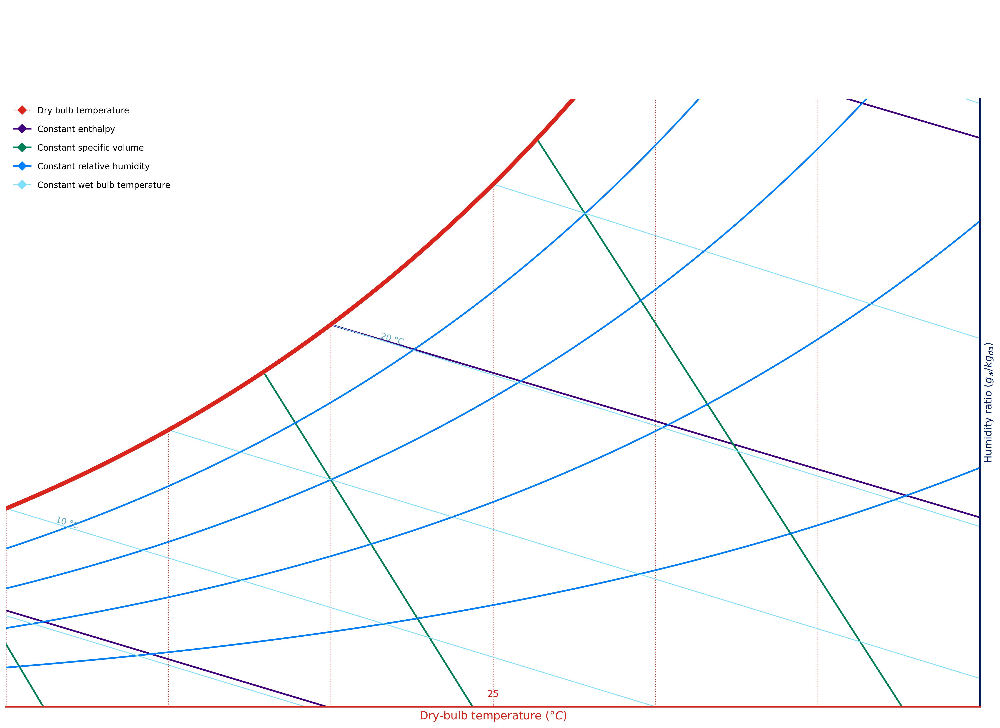

In [8]:
chart_ashrae_customized = PsychroChart(config_minimal)
ax = chart_ashrae_customized.plot()
chart_ashrae_customized.plot_legend(markerscale=.7, frameon=False, fontsize=10, labelspacing=1.2)
ax.get_figure()

In [31]:
chart_template = 'ashrae'
config_ashrae = load_config(chart_template)
config_ashrae

{'figure': {'figsize': [16, 9],
  'base_fontsize': 10,
  'title': 'Psychrometric Chart (sea level)',
  'x_label': 'DRY-BULB TEMPERATURE, $°C$',
  'y_label': 'HUMIDITY RATIO $w, g_w / kg_{da}$',
  'x_axis': {'color': [0.0, 0.0, 0.0], 'linewidth': 1.5, 'linestyle': '-'},
  'x_axis_labels': {'color': [0.0, 0.0, 0.0], 'fontsize': 8},
  'y_axis': {'color': [0.0, 0.0, 0.0], 'linewidth': 1.5, 'linestyle': '-'},
  'y_axis_labels': {'color': [0.0, 0.0, 0.0], 'fontsize': 8},
  'x_axis_ticks': {'direction': 'out', 'color': [0.0, 0.0, 0.0]},
  'y_axis_ticks': {'direction': 'out', 'color': [0.0, 0.0, 0.0]},
  'partial_axis': False,
  'position': [0.025, 0.075, 0.925, 0.875]},
 'limits': {'range_temp_c': [0, 50],
  'range_humidity_g_kg': [0, 30],
  'altitude_m': 0,
  'pressure_kpa': None,
  'step_temp': 1.0},
 'saturation': {'color': [0.0, 0.0, 0.0], 'linewidth': 2, 'linestyle': '-'},
 'constant_rh': {'color': [0.0, 0.0, 0.0], 'linewidth': 1, 'linestyle': '-'},
 'constant_v': {'color': [0.0, 0.0, 0.

In [35]:
config_ashrae['limits']['range_temp_c'] = [5, 35]
config_ashrae['limits']['range_humidity_g_kg'] = [0, 40]

config_ashrae['chart_params']['with_constant_wet_temp'] = False
config_ashrae['chart_params']['with_constant_v'] = False
config_ashrae['chart_params']['with_constant_dry_temp'] = True
config_ashrae['chart_params']['with_constant_humidity'] = True

#config_ashrae['chart_params']['constant_v_label'] = None
#config_ashrae['chart_params']['constant_temp_label'] = None
#config_ashrae['chart_params']['constant_h_label'] = None

#config_ashrae['chart_params']['constant_humid_label'] = None
#config_ashrae['chart_params']['constant_rh_label'] = None

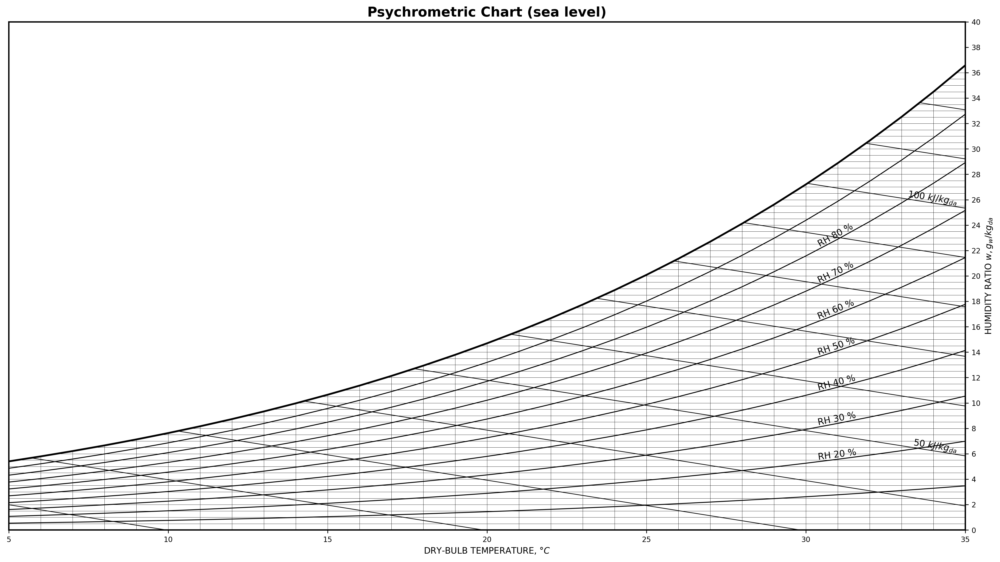

In [36]:
chart_ashrae_customized = PsychroChart(config_ashrae)
ax = chart_ashrae_customized.plot()
#chart_ashrae_customized.plot_legend(markerscale=.7, frameon=False, fontsize=10, labelspacing=1.2)
# ax.get_figure().savefig('psy.svg')
ax.get_figure()

## function: pass in inputdata from dataframe    

In [23]:
# original function
def plot_psy_from_df(df_data, chart_template = 'ashrae', alpha = 0.6, ncol = 3, save_fig_name = False):
    
    # pre-configuration
    # Get a pre-configured style dict
    config_ashrae = load_config(chart_template)

    # customize configuration:
    config_ashrae['chart_params']['with_constant_wet_temp'] = False
    config_ashrae['chart_params']['constant_temp_label'] = None
    config_ashrae['chart_params']['constant_h_label'] = None
    config_ashrae['chart_params']['constant_v_label'] = None
    config_ashrae['chart_params']['constant_humid_label'] = None
    config_ashrae['chart_params']['constant_rh_label'] = None

    chart_customized_ashrae = PsychroChart(config_ashrae)
    # Plot the chart
    ax = chart_customized_ashrae.plot()
    
    points = {}
    connectors = []
    for i in df_data.index:
        
        # inlet
        air_in = 'air_in_{}'.format(i)
        T_air_in = df_data.loc[i, "T_a_in"]
        rh_air_in = df_data.loc[i, "hr_air_in"]        
        
        # outlet
        air_out = 'air_out_{}'.format(i)
        T_air_out = df_data.loc[i, "T_a_o_exp"]
        rh_air_out = df_data.loc[i, "hr_air_out"]
        
        # color
        color = np.append(np.random.rand(3), alpha)
        print(color)
        
        # plot points
        point = {air_in: {'label': 'air_in_{}'.format(i),
                           'style': {'color': color,
                                     'marker': 'X', 'markersize': 15},
                           'xy': (T_air_in-273.15, rh_air_in*100)},
              air_out: {
                  'label': 'air_out_{}'.format(i),
                  'style': {'color': color,
                            'marker': 'o', 'markersize': 10},
                  'xy': (T_air_out-273.15, rh_air_out*100)}                      
                    }
        
        # plot connectors
        # here the color CANNOT be specified by string e.g. red...
        connector = {'start': air_in,
                       'end': air_out,
                       'style': {'color': color,
                                 "linewidth": 2, "linestyle": "-."}}
        
        # add into dict and list
        points.update(point)
        connectors.append(connector)
        
    # add points and conncection to chart
    chart_customized_ashrae.plot_points_dbt_rh(points, connectors)

    # Add a legend
    chart_customized_ashrae.plot_legend(markerscale=.7, frameon=False, fontsize=5, labelspacing=1.2, ncol = ncol)
    
    if save_fig_name:
        ax.get_figure().savefig(save_fig_name)
    
    return ax.get_figure()

In [9]:
# adapted function by rotem for color distinction
def plot_psy_from_df_rotem(df_data, chart_template = 'ashrae', alpha = 0.6, save_fig_name = False):
    
    # df_data is a pandas dataframe, for example, read directly from table of expertiment data.
    
    # pre-configuration
    # Get a pre-configured style dict
    config_ashrae = load_config(chart_template)
    config_ashrae['chart_params']['with_constant_wet_temp'] = False
    config_ashrae['chart_params']['constant_temp_label'] = None
    config_ashrae['chart_params']['constant_h_label'] = None
    config_ashrae['chart_params']['constant_v_label'] = None
    config_ashrae['chart_params']['constant_humid_label'] = None
    config_ashrae['chart_params']['constant_rh_label'] = None

    chart_customized_ashrae = PsychroChart(config_ashrae)
    
    # Plot the chart
    ax = chart_customized_ashrae.plot()
    points = {}
    connectors = []
    run=0#ROTEMS CODE - first run need to be out of the loop#######################################
    array_colors=[]#ROTEMS CODE - the 2D array that contains the different colors values####################################
    for i in df_data.index:
        
        # inlet
        air_in = 'air_in_{}'.format(i)
        T_air_in = df_data.loc[i, "T_a_in"]
        rh_air_in = df_data.loc[i, "hr_air_in"]        
        
        # outlet
        air_out = 'air_out_{}'.format(i)
        T_air_out = df_data.loc[i, "T_a_o_exp"]
        rh_air_out = df_data.loc[i, "hr_air_out"]
        
        # color
        #Rotem's Code strats:##################################################################################
        if (run==0):#the color of the first sample does not need to be sorted
            col=np.random.rand(3)
            color = np.append(col, alpha)
            array_colors.append(col)#stacking the different colors in a 2D list
        else:#for all the samples after the first sample:
            x=0
            similar=0
            while(x==0):#this loop will keep running until it will find a color that is different enough from all the other colors before 
                col=np.random.rand(3)
                color = np.append(col, alpha)
                for k in range(len(array_colors)):#this loop runs on all the colors that were used so far 
                    similar=0
                    for j in range(3):#this loop runs on the three different color values
#**************************IF YOU RUN A PROGRAMM WITH MORE THAN 24 VALUES YOU WILL NEED TO MAKE THE VALUES IN******************** 
#**************************(0.25+/-array_colors[k][j]))SMALLER THAN 0.25, OTHERWISE IT WILL NOT STOP RUNNING*********************
                        if (color[j]<(0.25+array_colors[k][j])) and (color[j]>(array_colors[k][j]-0.25)):
                            similar+=1#a test value for color who is too similar to a previews colors 
                    if similar==3: break
                        
                if (similar>=3):#if the tested color has three color values whom are close to some of the colors before, so the
                    #loop will keep running another time with a new color
                    x=0
                    similar=0
                else:#if the similar value is not 3 ,so the tested color is different enough from all the colors before
                    x=1
                    array_colors.append(col)
                    print(color)
        run=1#so the first run will be confirmed out of the loop
        #Rotem's Code ends:##################################################################################
        
        # plot points
        point = {air_in: {'label': 'air_in_{}'.format(i),
                           'style': {'color': color,
                                     'marker': 'X', 'markersize': 15},
                           'xy': (T_air_in-273.15, rh_air_in*100)},
              air_out: {
                  'label': 'air_out_{}'.format(i),
                  'style': {'color': color,
                            'marker': 'o', 'markersize': 10},
                  'xy': (T_air_out-273.15, rh_air_out*100)}                      
                    }
        # plot connectors
        # here the color CANNOT be specified by string e.g. red...
        
        connector = {'start': air_in,
                       'end': air_out,
                       'style': {'color': color,
                                 "linewidth": 2, "linestyle": "-."}}
        # add into dict and list
        points.update(point)
        connectors.append(connector)
        
    # add points and conncection to chart
    chart_customized_ashrae.plot_points_dbt_rh(points, connectors)

    # Add a legend
    chart_customized_ashrae.plot_legend(markerscale=.7, frameon=False, fontsize=8, labelspacing=1.2, ncol = 3)
    
    if save_fig_name:
        ax.get_figure().savefig(save_fig_name)
    
    return ax.get_figure()

## function: pass in inputdata as list

In [14]:
# plot from list
def plot_psy_from_list(li_temp, li_RH, chart_template = 'ashrae', alpha = 0.6, save_fig_name = False):
    
    assert len(li_temp) == len(li_RH), 'the length of two list should be identical.'
    # pre-configuration
    # Get a pre-configured style dict
    config_ashrae = load_config(chart_template)

    # customize configuration:

    config_ashrae['chart_params']['with_constant_wet_temp'] = False
    config_ashrae['chart_params']['constant_temp_label'] = None
    config_ashrae['chart_params']['constant_h_label'] = None
    config_ashrae['chart_params']['constant_v_label'] = None
    config_ashrae['chart_params']['constant_humid_label'] = None
    config_ashrae['chart_params']['constant_rh_label'] = None

    chart_customized_ashrae = PsychroChart(config_ashrae)
    
    # Plot the chart
    ax = chart_customized_ashrae.plot()
    
    points = {}
    connectors = []
    for i in range(len(li_temp)):
        # inlet
        air_in = 'air_in_{}'.format(i)
        T_air_in = li_temp[i]
        rh_air_in = li_RH[i]      
        
        # outlet
        air_out = 'air_out_{}'.format(i)
        T_air_out = df_data.loc[i, "T_a_o_exp"]
        rh_air_out = df_data.loc[i, "hr_air_out"]
        
        # color
        color = np.append(np.random.rand(3), alpha)
        print(color)
        
        # plot points
        point = {air_in: {'label': 'air_in_{}'.format(i),
                           'style': {'color': color,
                                     'marker': 'X', 'markersize': 15},
                           'xy': (T_air_in-273.15, rh_air_in)},
              air_out: {
                  'label': 'air_out_{}'.format(i),
                  'style': {'color': color,
                            'marker': 'o', 'markersize': 10},
                  'xy': (T_air_out-273.15, rh_air_out)}                      
                    }
        
        # plot connectors
        # here the color CANNOT be specified by string e.g. red...
        connector = {'start': air_in,
                       'end': air_out,
                       'style': {'color': color,
                                 "linewidth": 2, "linestyle": "-."}}
        
        # add into dict and list
        points.update(point)
        connectors.append(connector)
        
    # add points and conncection to chart
    chart_customized_ashrae.plot_points_dbt_rh(points, connectors)

    # Add a legend
    chart_customized_ashrae.plot_legend(markerscale=.7, frameon=False, fontsize=10, labelspacing=1.2)
    
    if save_fig_name:
        ax.get_figure().savefig(save_fig_name)
    
    return ax.get_figure()

In [ ]:
ax = chart_customized_ashrae.plot()
points = {'air_in_1': {'label': 'air_in_1',
                       'style': {'color': "red",
                                 'marker': 'X', 'markersize': 15},
                       'xy': (304.65-273.15, 12.55)},
          'air_out_1': {
              'label': 'air_out_1',
              'style': {'color': "red",
                        'marker': 'o', 'markersize': 10},
              'xy': (302.62-273.15, 28.03)},
          
          'air_in_2': {'label': 'air_in_2',
                       'style': {'color': 'green',
                                 'marker': 'X', 'markersize': 15},
                       'xy': (304.65-273.15, 12.55)},
          
          'air_out_2':{
              'label':'air_out_2',
              'style':{'color':'green', 'marker':'o', 'markersize':10},
              'xy': (302.62-273.15, 20.03)},                         
}

# here the color CANNOT be specified by string e.g. red...
connectors = [{'start': 'air_in_1',
               'end': 'air_out_1',
               'style': {'color': [1,0,0,0.8],
                         "linewidth": 2, "linestyle": "-."}},
              {'start': 'air_in_2',
               'end': 'air_out_2',
               'style': {'color': [0, 1, 0, 0.8],
                         "linewidth": 5, "linestyle": "-."}},    ]


chart_customized_ashrae.plot_points_dbt_rh(points, connectors)

# Add a legend
chart_customized_ashrae.plot_legend(markerscale=.7, frameon=False, fontsize=10, labelspacing=1.2)
ax.get_figure()

# plot exp data from table

## dempav Aug 2020

### all points

In [7]:
df_exp_dempav = pd.read_excel("../../exp_data/actual_data/dempav/dempav_T_des_corrected.xlsx", index_col=0)
df_exp_dempav.head()

,T_a_in,hr_air_in,m_a_in,T_d_in,xi_d_in,m_d_in,T_a_o_exp,hr_air_out,T_d_o_exp,x_a_in,x_a_o_exp
0,298.02,0.480462,0.018848,287.44,0.318302,0.102670,290.21,0.476947,286.230,0.009457,0.005773
1,300.51,0.553303,0.036283,292.20,0.318186,0.102670,294.81,0.538242,290.092,0.012683,0.008716
2,298.02,0.458659,0.032644,284.16,0.318572,0.102670,287.98,0.506137,281.766,0.009022,0.005308
3,301.31,0.504712,0.036150,290.94,0.318174,0.102669,293.69,0.519635,288.468,0.012112,0.007844
4,299.87,0.423994,0.045742,290.34,0.318171,0.102668,292.89,0.525218,288.366,0.009311,0.007542


[0.5647437  0.14577027 0.91584783 0.8       ]
[0.31195364 0.76941022 0.14257581 0.8       ]
[0.05244012 0.68470061 0.72414464 0.8       ]
[0.38331914 0.62674346 0.61442437 0.8       ]
[0.16038829 0.2233713  0.90548946 0.8       ]
[0.5874926  0.15382595 0.1341383  0.8       ]
[0.79519608 0.91567701 0.20327381 0.8       ]
[0.96153611 0.20068375 0.416556   0.8       ]
[0.06508218 0.13685908 0.01123672 0.8       ]
[0.61186227 0.51775496 0.91258527 0.8       ]
[0.88140571 0.31251058 0.11804264 0.8       ]
[0.09939659 0.97431474 0.53717174 0.8       ]
[0.71281805 0.85660774 0.88528793 0.8       ]
[0.00535029 0.71447216 0.13439415 0.8       ]
[0.72913681 0.8296783  0.4954177  0.8       ]
[0.00125579 0.27952135 0.3850868  0.8       ]
[0.4334597  0.26795002 0.60828029 0.8       ]
[0.93991382 0.04859034 0.7745863  0.8       ]
[0.01153495 0.67231203 0.99637439 0.8       ]
[0.52333363 0.51077186 0.24055502 0.8       ]
[0.69012836 0.08245409 0.45812482 0.8       ]
[0.04279097 0.05014233 0.6552464  

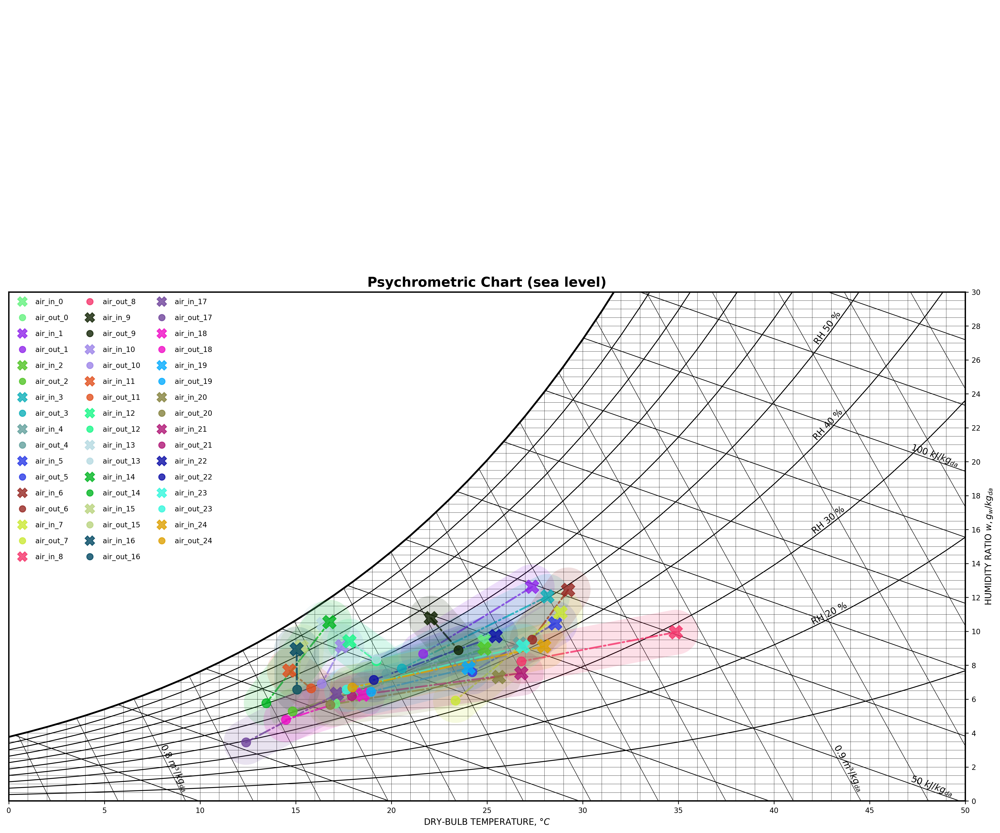

In [10]:
plot_psy_from_df_rotem(df_data=df_exp_dempav, alpha=0.8, ) # save_fig_name='dempav_2021_all.png' 

### absorption + cooling

In [11]:
# remove specious point from the whole list
# questionable point 8, 14, for the moment remained in the chart
# 7 also removed, because the outlet air humidity smaller than the desiccant equivalent humidity ratio
df_exp_dempav_selected = df_exp_dempav.drop([7, 9, 10, 11, 12, 13, 15, 16])
df_exp_dempav_selected.shape

(17, 11)

[0.53287153 0.48546429 0.47670017 0.8       ]
[0.66496301 0.77720521 0.75039954 0.8       ]
[0.31141339 0.04750409 0.34594775 0.8       ]
[0.57945034 0.78929247 0.33919185 0.8       ]
[0.03598616 0.75540475 0.02545055 0.8       ]
[0.03681196 0.39509642 0.97472785 0.8       ]
[0.60212016 0.50786395 0.11623244 0.8       ]
[4.89758221e-04 5.41332491e-01 6.63509694e-01 8.00000000e-01]
[0.26140826 0.47554465 0.45608338 0.8       ]
[0.59596353 0.40612367 0.90892414 0.8       ]
[0.066045   0.75835286 0.38118767 0.8       ]
[0.33548863 0.76610082 0.87020569 0.8       ]
[0.00212064 0.06667815 0.17910288 0.8       ]
[0.56111253 0.14250947 0.75259398 0.8       ]
[0.84484653 0.84905952 0.48279626 0.8       ]
[0.61068286 0.88114358 0.08100804 0.8       ]


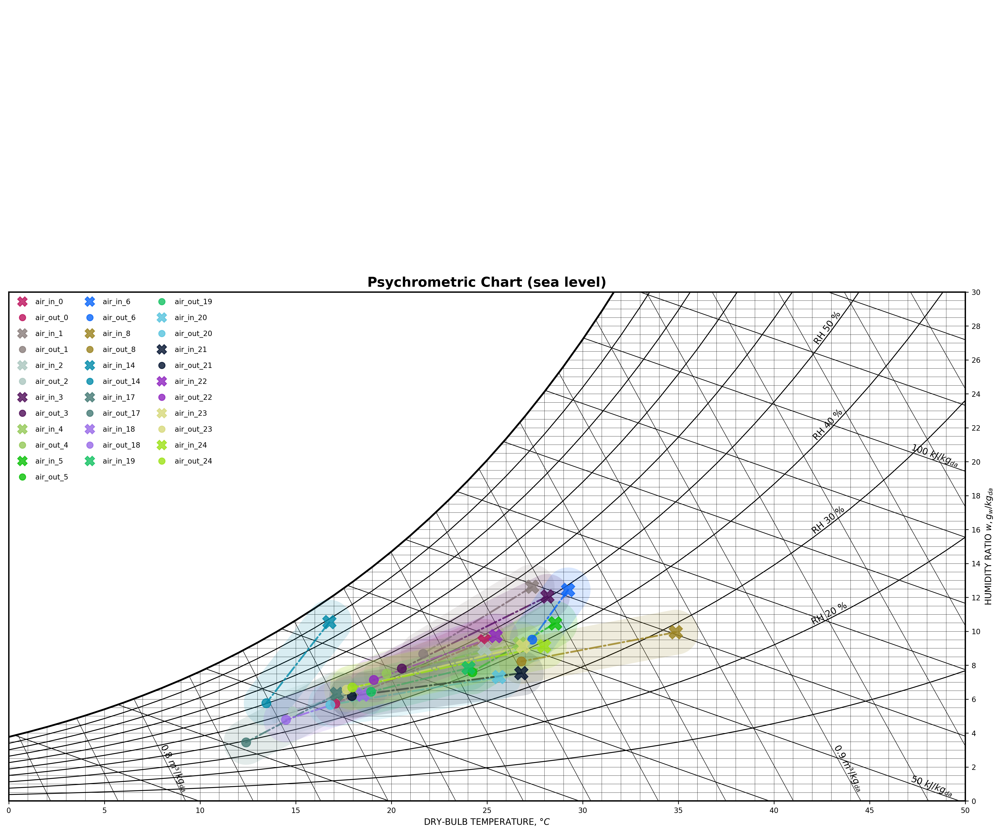

In [12]:
plot_psy_from_df_rotem(df_data=df_exp_dempav_selected, alpha=0.8, ) #save_fig_name='dempav_2021_all.png' 

In [37]:
# df_exp_dempav_selected.to_excel('dempav_selected_absorption_point.xlsx')

### wired points

In [17]:
df_exp_dempav_deselected = df_exp_dempav.loc[[9, 10, 11, 12, 13, 15, 16],:]

[0.58988871 0.49699283 0.45290733 0.8       ]
[0.80291995 0.17336911 0.69175613 0.8       ]
[0.52371471 0.08789998 0.11043657 0.8       ]
[0.46014817 0.95426325 0.42366422 0.8       ]
[0.89395233 0.31498806 0.36885644 0.8       ]
[0.3875218  0.08264161 0.61637304 0.8       ]


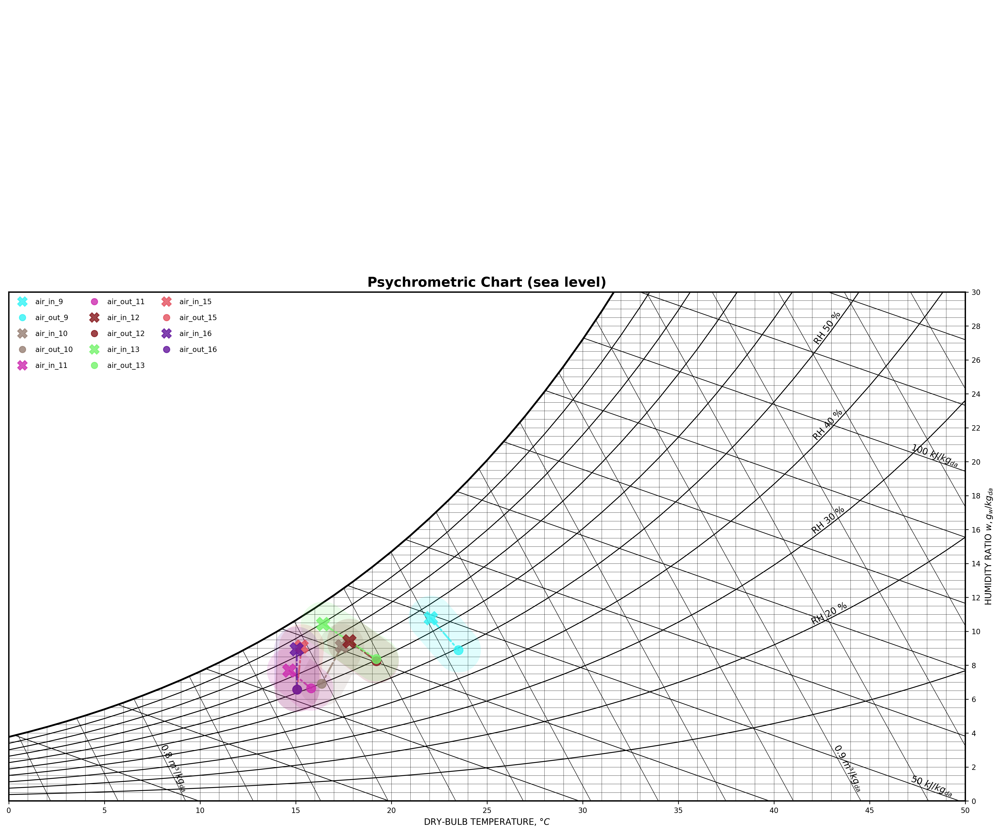

In [19]:
plot_psy_from_df_rotem(df_data=df_exp_dempav_deselected, alpha=0.8, save_fig_name='dempav_2021_other.png' ) #save_fig_name='dempav_2021_all.png' 

## Teststand

### all data

In [38]:
df_teststand_all = pd.read_excel("../../exp_data/actual_data/teststand_with_x_d_in_all.xlsx", index_col=0)
df_teststand_all.shape

(62, 15)

In [39]:
df_teststand_all.head()

,T_a_in,hr_air_in,V_a_in,m_a_in,T_d_in,xi_d_in,V_d_in,rho_d_in,m_d_in,T_a_o_exp,hr_air_out,T_d_o_exp,x_a_in,x_a_o_exp,x_d_in_equ
0,297.04,0.8720,46.52,0.014969,298.21,0.313764,1.31,1292.0,0.028209,301.27,0.5124,298.84,0.016362,0.012271,0.009253
1,299.92,0.7981,47.22,0.015014,300.91,0.311185,1.28,1289.0,0.027499,303.40,0.5093,301.59,0.017815,0.013828,0.011082
2,299.94,0.8382,19.50,0.006191,300.29,0.314032,1.18,1292.0,0.025409,303.52,0.4944,300.98,0.018759,0.013509,0.010496
3,300.49,0.7569,18.49,0.005871,301.85,0.312199,0.75,1290.0,0.016125,304.04,0.4688,302.48,0.017460,0.013190,0.011662
4,301.58,0.8659,18.90,0.005943,303.40,0.312333,0.22,1290.0,0.004730,306.72,0.4914,304.58,0.021418,0.016161,0.012790


[0.84818631 0.12895938 0.21732103 0.6       ]
[0.33961748 0.70751496 0.48953519 0.6       ]
[0.82563592 0.18835588 0.7312557  0.6       ]
[0.76657804 0.72240231 0.84221286 0.6       ]
[0.78725    0.22833151 0.61375915 0.6       ]
[0.08472593 0.33689976 0.31647292 0.6       ]
[0.59680926 0.88965136 0.97722276 0.6       ]
[0.78585365 0.40385422 0.5844376  0.6       ]
[0.4644173  0.83874328 0.16615067 0.6       ]
[0.93242321 0.5935781  0.00751369 0.6       ]
[0.87594558 0.49254433 0.95009664 0.6       ]
[0.47087809 0.48817367 0.94445059 0.6       ]
[0.22810731 0.53522936 0.27166563 0.6       ]
[0.86036334 0.65857448 0.18994639 0.6       ]
[0.49004381 0.56650438 0.17980869 0.6       ]
[0.94183489 0.817444   0.16776425 0.6       ]
[0.29921265 0.58849795 0.38747247 0.6       ]
[0.5235729  0.59140837 0.87548831 0.6       ]
[0.24348575 0.66447801 0.06352312 0.6       ]
[0.98106117 0.62204917 0.59732751 0.6       ]
[0.30935053 0.87065918 0.63612609 0.6       ]
[0.46402875 0.50431802 0.93157071 

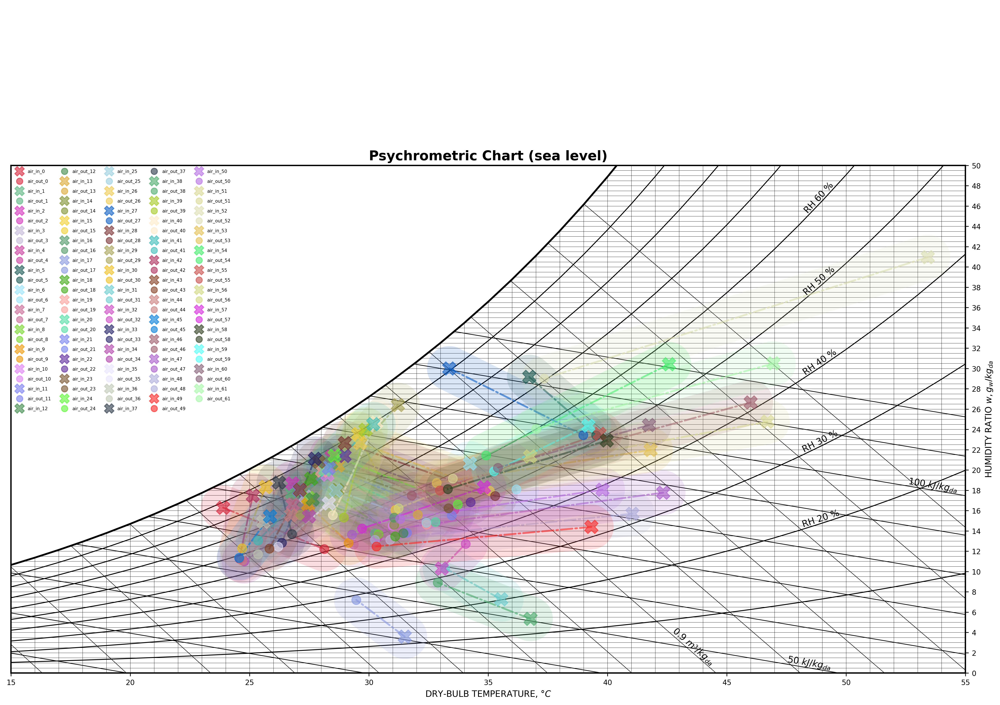

In [40]:
plot_psy_from_df(df_data=df_teststand_all, chart_template=config_ashrae, ncol=5, save_fig_name='teststand_2021_all.png' )

### Cooling + dehumidification

In [44]:
df_teststand_cool = df_teststand_all.query('T_a_in - T_a_o_exp >= 5 & x_a_in - x_a_o_exp >0')
df_teststand_cool.shape

(15, 15)

In [46]:
df_teststand_cool.to_excel('teststand_cool_5.xlsx')

In [42]:
index_cool = df_teststand_cool.index

In [112]:
# plot_psy_from_df_rotem(df_data=df_teststand_cool, ) #chart_template=custom_style

[0.10217333 0.8083823  0.78805156 0.6       ]
[0.36795122 0.34815694 0.60902471 0.6       ]
[0.60693347 0.75093914 0.42981089 0.6       ]
[0.81392675 0.34850844 0.02947897 0.6       ]
[0.32348684 0.53966693 0.30096357 0.6       ]
[0.93462453 0.90153336 0.98931993 0.6       ]
[0.88028767 0.91824576 0.57695079 0.6       ]
[0.83646316 0.75158442 0.14041576 0.6       ]
[0.12791257 0.01730721 0.14959121 0.6       ]
[0.62677852 0.02521052 0.55011229 0.6       ]
[0.324596   0.87759774 0.43210069 0.6       ]
[0.40012623 0.19240807 0.17840703 0.6       ]
[0.0890713  0.30894306 0.59414885 0.6       ]
[0.3864773  0.09366808 0.90764639 0.6       ]


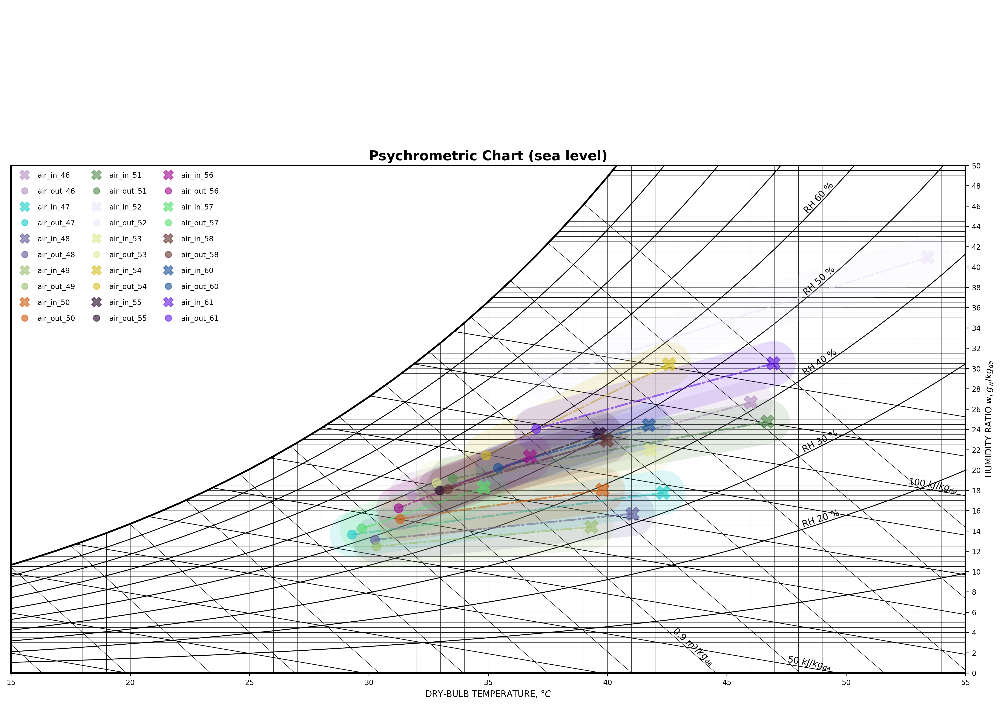

In [45]:
plot_psy_from_df_rotem(df_data=df_teststand_cool, chart_template=config_ashrae, ) #save_fig_name='teststand_2021_CoolAbs.png' 

### heating + dehumidification

In [28]:
df_teststand_heat = df_teststand_all.query('T_a_in - T_a_o_exp < 0 & x_a_in - x_a_o_exp >0')
df_teststand_heat.shape

(29, 15)

In [29]:
index_heat = df_teststand_heat.index

[0.50946769 0.2477114  0.36091148 0.6       ]
[0.75826069 0.72723271 0.05656189 0.6       ]
[0.45160513 0.91360484 0.90301248 0.6       ]
[0.43997275 0.6380772  0.05636663 0.6       ]
[0.17422842 0.2441479  0.87090173 0.6       ]
[0.02537652 0.74037117 0.38086584 0.6       ]
[0.94875361 0.33690352 0.38524661 0.6       ]
[0.92201781 0.70586997 0.80576923 0.6       ]
[0.97094616 0.63806277 0.34444299 0.6       ]
[0.28058331 0.8369076  0.55452759 0.6       ]
[0.76105499 0.43504979 0.97554781 0.6       ]
[0.46177263 0.33221455 0.73125108 0.6       ]
[0.67316863 0.02905093 0.8580201  0.6       ]
[0.54462219 0.90477101 0.65206864 0.6       ]
[0.49908474 0.11717225 0.07652142 0.6       ]
[0.56482552 0.63037692 0.61432034 0.6       ]
[0.00622382 0.49551953 0.86347602 0.6       ]
[0.04834383 0.48136095 0.07825805 0.6       ]
[0.9410156  0.44135261 0.07417997 0.6       ]
[0.80922989 0.05385689 0.0892584  0.6       ]
[0.04721905 0.96177915 0.9995565  0.6       ]
[0.04092518 0.41001582 0.44652019 

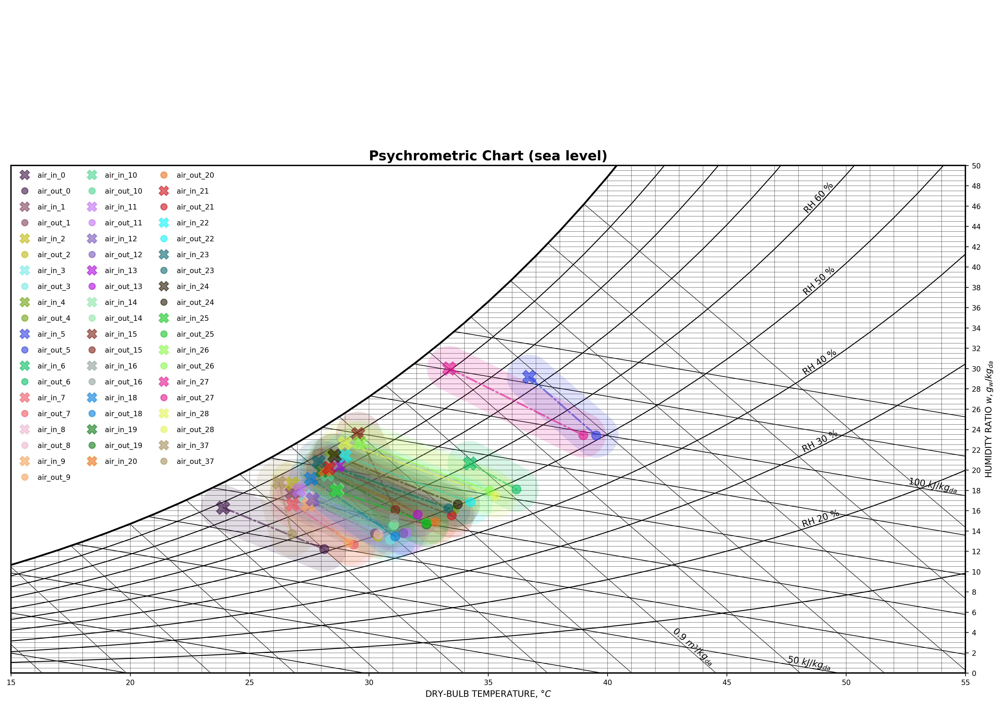

In [32]:
plot_psy_from_df_rotem(df_data=df_teststand_heat, chart_template=config_ashrae, save_fig_name='teststand_2021_heat.png' )

### middle

In [33]:
df_teststand_middle = df_teststand_all.drop(index_cool.tolist() + index_heat.tolist())
df_teststand_middle.shape

(8, 15)

[0.37377647 0.30724393 0.05406554 0.6       ]
[0.51864471 0.6479134  0.52335668 0.6       ]
[0.56391563 0.28609192 0.93535527 0.6       ]
[0.62862003 0.95804414 0.64153957 0.6       ]
[0.93025956 0.65735731 0.99559541 0.6       ]
[0.26136602 0.47766615 0.89618998 0.6       ]
[0.796125   0.73562012 0.03415299 0.6       ]


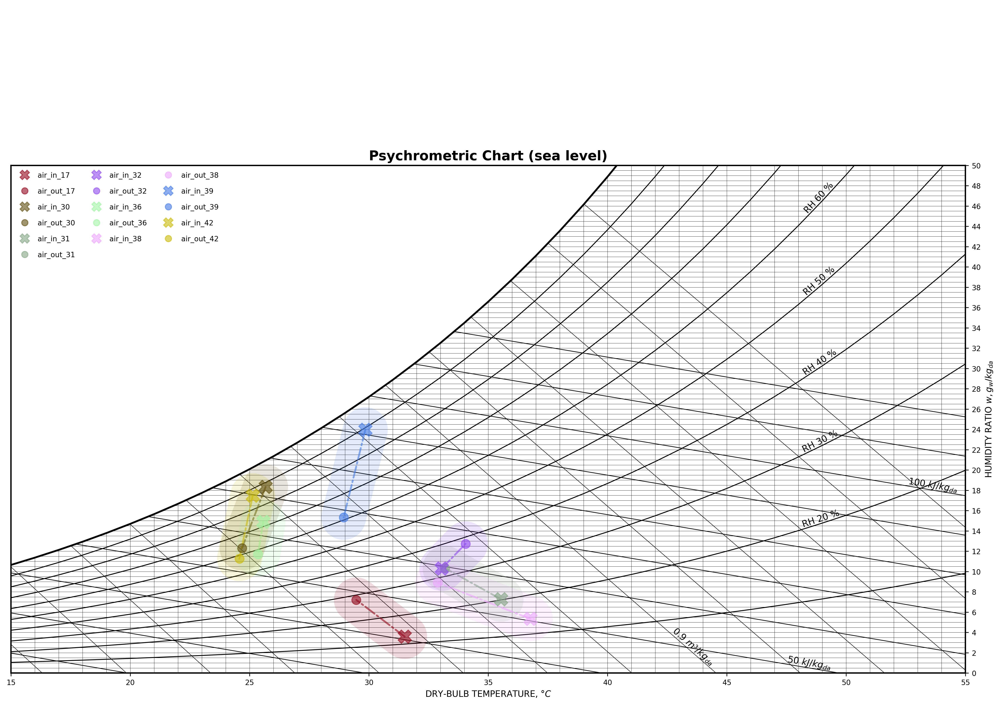

In [35]:
plot_psy_from_df_rotem(df_data=df_teststand_middle, chart_template=config_ashrae, save_fig_name='teststand_2021_other.png' )

## Writer to excel

In [144]:
path = 'EnBA_M_selected_data.xlsx'
with pd.ExcelWriter(path) as writer:
    df_exp_dempav_selected.to_excel(writer, sheet_name='dempav_cool')
    df_teststand_cool.to_excel(writer, sheet_name='teststand_cool_deh')
    df_teststand_heat.to_excel(writer, sheet_name='teststand_heat_deh')
    df_teststand_middle.to_excel(writer, sheet_name='teststand_others')
    writer.save()
    writer.close()

## Chen Experiment data

In [16]:
df_chen_data = pd.read_excel("../exp_data/actual_data/Chen2016.xlsx", index_col=0)

In [17]:
df_chen_data['hr_air_in'] = np.vectorize(convert_to_hr)(df_chen_data.T_a_in, df_chen_data.x_a_in)*100
df_chen_data['hr_air_out'] = np.vectorize(convert_to_hr)(df_chen_data.T_a_o_exp, df_chen_data.x_a_o_exp)*100

In [18]:
df_chen_data.head()

,T_a_in,x_a_in,m_a_in,T_d_in,xi_d_in,m_d_in,T_a_o_exp,x_a_o_exp,T_d_o_exp,xi_d_o_exp,T_d_o_sim,T_a_o_sim,x_a_o_sim,hr_air_in,hr_air_out
1,298.75,0.0162,1.85,288.05,0.230,2.61,292.35,0.0091,294.45,0.2288,20.19,291.89,9.29,77.969731,65.375182
2,301.75,0.0202,1.87,291.35,0.240,2.63,296.05,0.0116,298.35,0.2385,24.45,295.41,11.41,81.015616,66.121586
3,300.65,0.0181,1.92,290.85,0.255,2.65,295.05,0.0099,297.45,0.2535,23.69,294.59,10.08,77.653446,60.132028
4,303.15,0.0177,1.89,292.05,0.260,2.66,296.65,0.0097,298.95,0.2585,24.74,296.10,10.22,65.732435,53.481911
5,300.75,0.0164,1.92,290.45,0.270,2.67,294.75,0.0087,296.85,0.2685,23.10,294.19,9.03,70.135908,53.923807


[0.75993086 0.49723503 0.2646069  0.8       ]
[0.98074733 0.74720127 0.31262592 0.8       ]
[0.67611689 0.76835984 0.33977388 0.8       ]
[0.92015398 0.55039682 0.25687365 0.8       ]
[0.5310076  0.36175623 0.92172453 0.8       ]
[0.18869912 0.01640105 0.26911219 0.8       ]
[0.47429209 0.84493215 0.37486371 0.8       ]
[0.76958461 0.10344852 0.22900431 0.8       ]
[0.98857548 0.6595277  0.829492   0.8       ]
[0.18052519 0.5041162  0.6138081  0.8       ]
[0.5194566  0.32535215 0.81072523 0.8       ]
[0.50347086 0.6869875  0.53278552 0.8       ]
[0.64208806 0.64434379 0.45845364 0.8       ]
[0.31527965 0.08554654 0.10498597 0.8       ]
[0.89254858 0.94836139 0.1281364  0.8       ]


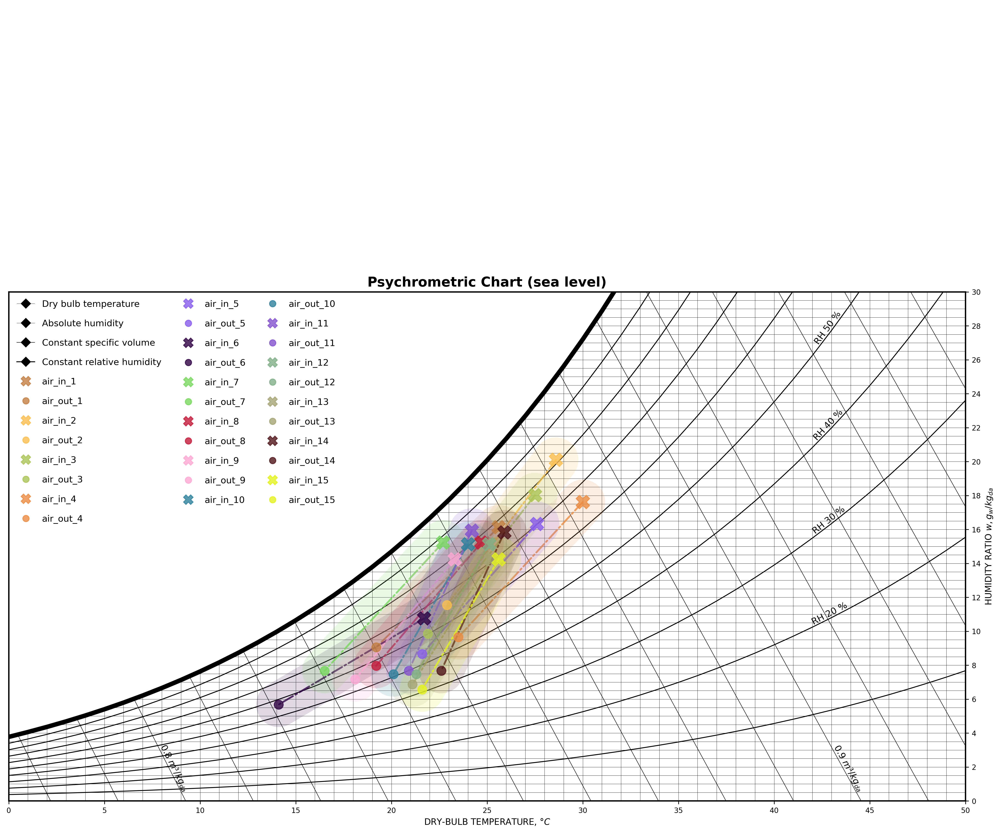

In [19]:
plot_psy_from_df(df_data=df_chen_data, alpha=0.8, ) #save_fig_name='chen2016.png'

## ZHAW data

In [20]:
df_ZHAW_data = pd.read_excel("../exp_data/actual_data/ZHAW_data.xlsx", index_col=0)

In [21]:
df_ZHAW_data['hr_air_in'] = np.vectorize(convert_to_hr)(df_ZHAW_data.T_a_in, df_ZHAW_data.x_a_in)*100
df_ZHAW_data['hr_air_out'] = np.vectorize(convert_to_hr)(df_ZHAW_data.T_a_o_exp, df_ZHAW_data.x_a_o_exp)*100

In [22]:
df_ZHAW_data.head()

,T_a_in,x_a_in,m_a_in,T_d_in,xi_d_in,m_d_in,T_a_o_exp,x_a_o_exp,T_d_o_exp,hr_air_in,hr_air_out
1,305.65,0.0170,0.27,289.55,0.33,0.62,293.45,0.0063,296.15,54.821144,42.460552
2,305.65,0.0170,0.27,290.15,0.33,0.62,294.05,0.0065,296.55,54.821144,42.203538
3,305.65,0.0230,0.27,292.65,0.33,0.62,296.25,0.0063,299.15,73.479773,35.777891
4,306.65,0.0224,0.27,295.45,0.34,0.63,298.55,0.0086,301.65,67.717099,42.390961
5,307.05,0.0233,0.27,297.85,0.34,0.63,300.05,0.0093,303.75,68.784869,41.904599


[0.99239557 0.59538849 0.39447089 0.6       ]
[0.08534253 0.5248002  0.89261634 0.6       ]
[0.99883926 0.00946527 0.76678618 0.6       ]
[0.54422899 0.99617667 0.97030513 0.6       ]
[0.17446529 0.8377266  0.36389279 0.6       ]
[0.94007394 0.08933548 0.83109126 0.6       ]
[0.17635899 0.69338895 0.31283775 0.6       ]
[0.97343312 0.03425657 0.54463076 0.6       ]
[0.47272948 0.82425066 0.14050001 0.6       ]
[0.70252023 0.20036799 0.25027357 0.6       ]
[0.10925489 0.54595317 0.65935129 0.6       ]
[0.20331801 0.94915245 0.1158878  0.6       ]
[0.50359888 0.28212128 0.69382955 0.6       ]
[0.19744967 0.14117146 0.8983456  0.6       ]
[0.80823626 0.69183557 0.13090812 0.6       ]
[0.37677246 0.95028247 0.23682891 0.6       ]
[0.51531216 0.74362516 0.22611693 0.6       ]
[0.1340086  0.74670335 0.98626484 0.6       ]
[0.48440816 0.67616133 0.7228623  0.6       ]
[0.92526655 0.22174533 0.14729434 0.6       ]


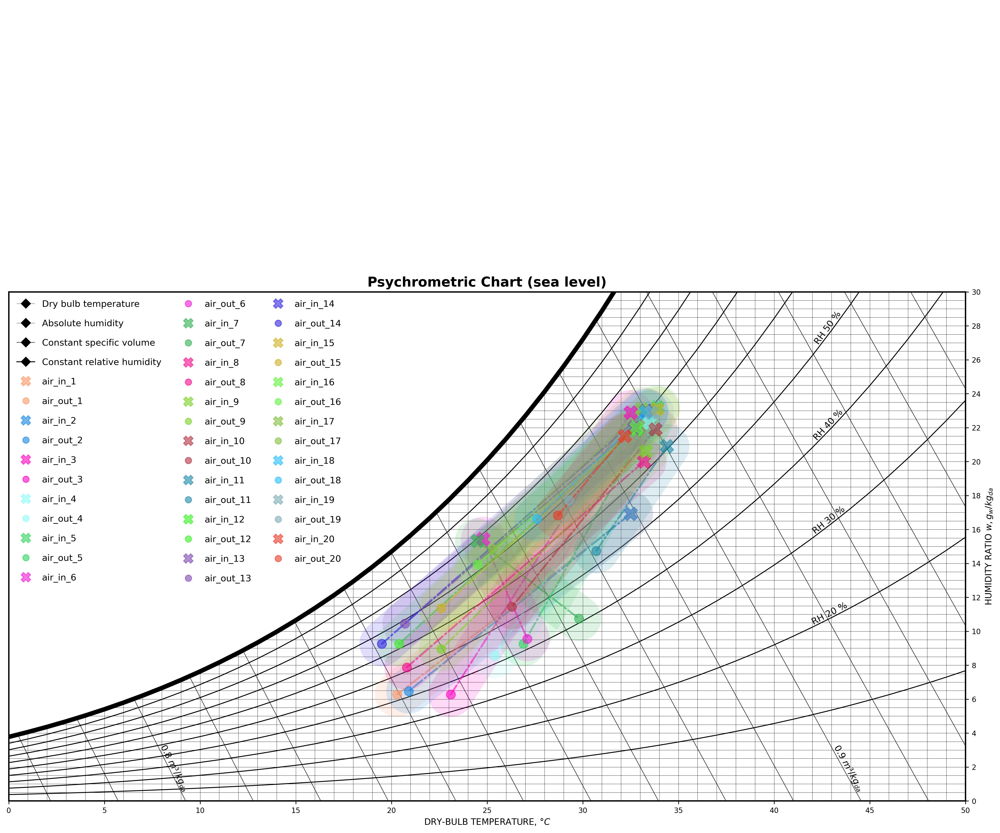

In [23]:
plot_psy_from_df(df_data=df_ZHAW_data, )

# customized psychrometric chart

**customize ASHREA**

In [56]:
chart_template = 'ashrae'
config_ashrae = load_config(chart_template)
config_ashrae

{'figure': {'figsize': [16, 9],
  'base_fontsize': 10,
  'title': 'Psychrometric Chart (sea level)',
  'x_label': 'DRY-BULB TEMPERATURE, $°C$',
  'y_label': 'HUMIDITY RATIO $w, g_w / kg_{da}$',
  'x_axis': {'color': [0.0, 0.0, 0.0], 'linewidth': 1.5, 'linestyle': '-'},
  'x_axis_labels': {'color': [0.0, 0.0, 0.0], 'fontsize': 8},
  'y_axis': {'color': [0.0, 0.0, 0.0], 'linewidth': 1.5, 'linestyle': '-'},
  'y_axis_labels': {'color': [0.0, 0.0, 0.0], 'fontsize': 8},
  'x_axis_ticks': {'direction': 'out', 'color': [0.0, 0.0, 0.0]},
  'y_axis_ticks': {'direction': 'out', 'color': [0.0, 0.0, 0.0]},
  'partial_axis': False,
  'position': [0.025, 0.075, 0.925, 0.875]},
 'limits': {'range_temp_c': [0, 50],
  'range_humidity_g_kg': [0, 30],
  'altitude_m': 0,
  'pressure_kpa': None,
  'step_temp': 1.0},
 'saturation': {'color': [0.0, 0.0, 0.0], 'linewidth': 2, 'linestyle': '-'},
 'constant_rh': {'color': [0.0, 0.0, 0.0], 'linewidth': 1, 'linestyle': '-'},
 'constant_v': {'color': [0.0, 0.0, 0.

In [60]:
config_ashrae['limits']['range_temp_c'] = [15, 55]
config_ashrae['limits']['range_humidity_g_kg'] = [0, 50]

config_ashrae['chart_params']['with_constant_wet_temp'] = False
config_ashrae['chart_params']['constant_temp_label'] = None
config_ashrae['chart_params']['constant_h_label'] = None
config_ashrae['chart_params']['constant_v_label'] = None
config_ashrae['chart_params']['constant_humid_label'] = None
config_ashrae['chart_params']['constant_rh_label'] = None

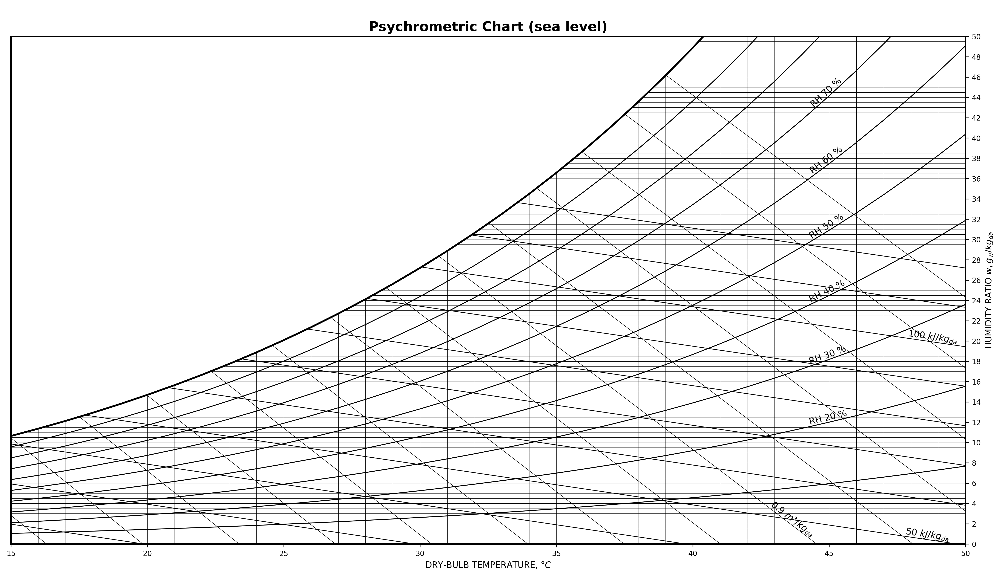

In [58]:
chart_ashrae_customized = PsychroChart(config_ashrae)
ax = chart_ashrae_customized.plot()
chart_ashrae_customized.plot_legend(markerscale=.7, frameon=False, fontsize=10, labelspacing=1.2)
ax.get_figure()

**fully customize**

In [48]:
# Pass a dict with the changes wanted:
custom_style = {
    "figure": {
        "figsize": [12, 8],
        "base_fontsize": 12,
        "title": "My chart",
        "x_label": None,
        "y_label": None,
        "partial_axis": False
    },
    "limits": {
        "range_temp_c": [10, 80],
        "range_humidity_g_kg": [0, 50],
        "altitude_m": 1000,
        "step_temp": .5
    },
    "saturation": {"color": [0, .3, 1.], "linewidth": 2},
    "constant_rh": {"color": [0.0, 0.498, 1.0, .7], "linewidth": 2.5,
                    "linestyle": ":"},
    "chart_params": {
        "with_constant_rh": True,
        "constant_rh_curves": np.arange(0, 100, 20),
        "constant_rh_labels": [25, 50, 75],
        
        "range_vol_m3_kg": [0.9, 1.2],
        "constant_v_labels": np.arange(0.9, 1.2, 0.02),
        
        "with_constant_h": True,
        "with_constant_wet_temp": False,
        "with_zones": False
    }
}

print("** Customized style from dict:\n{}\n".format(custom_style))

** Customized style from dict:
{'figure': {'figsize': [12, 8], 'base_fontsize': 12, 'title': 'My chart', 'x_label': None, 'y_label': None, 'partial_axis': False}, 'limits': {'range_temp_c': [10, 80], 'range_humidity_g_kg': [0, 50], 'altitude_m': 1000, 'step_temp': 0.5}, 'saturation': {'color': [0, 0.3, 1.0], 'linewidth': 2}, 'constant_rh': {'color': [0.0, 0.498, 1.0, 0.7], 'linewidth': 2.5, 'linestyle': ':'}, 'chart_params': {'with_constant_rh': True, 'constant_rh_curves': array([ 0, 20, 40, 60, 80]), 'constant_rh_labels': [25, 50, 75], 'range_vol_m3_kg': [0.9, 1.2], 'constant_v_labels': array([0.9 , 0.92, 0.94, 0.96, 0.98, 1.  , 1.02, 1.04, 1.06, 1.08, 1.1 ,
       1.12, 1.14, 1.16, 1.18]), 'with_constant_h': True, 'with_constant_wet_temp': False, 'with_zones': False}}



In [34]:
HAPropsSI('R','T', 273.15 + 56.6,'P',101325,'W',0.03927)

0.35178326335496907

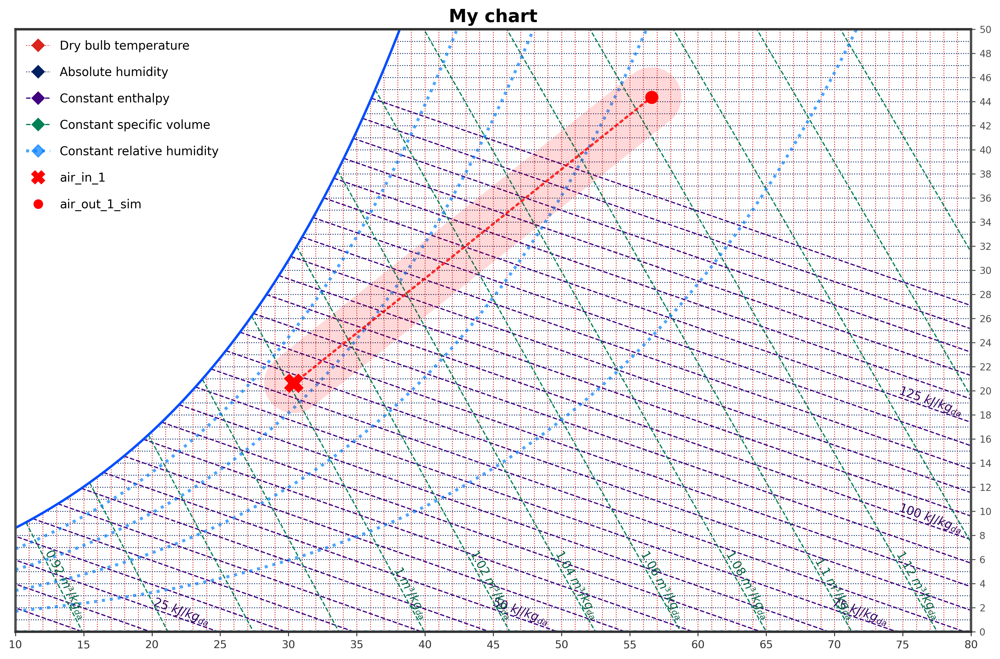

In [39]:
# select chart layout
chart_customized = PsychroChart(custom_style)

# here the color CAN be specified by string e.g. red...
ax = chart_customized.plot()
points = {'air_in_1': {'label': 'air_in_1',
                       'style': {'color': "red",
                                 'marker': 'X', 'markersize': 15},
                       'xy': (30.4, 66.36)},
          'air_out_1': {
              'label': 'air_out_1_sim',
              'style': {'color': "red",
                        'marker': 'o', 'markersize': 10},
              'xy': (56.6, 35.18)},
}

# here the color CANNOT be specified by string e.g. red...
connectors = [{'start': 'air_in_1',
               'end': 'air_out_1',
               'style': {'color': [1,0,0,0.8],
                         "linewidth": 2, "linestyle": ":"}},
              ]

# [0, 1, 0, 0.8]
chart_customized.plot_points_dbt_rh(points, connectors)

# Add a legend
chart_customized.plot_legend(markerscale=.7, frameon=False, fontsize=10, labelspacing=1.2)

ax.get_figure()
# ax.get_figure().savefig('reg_compare.png')